In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

from plotly import tools
from plotly.graph_objs import *
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

import plotly.graph_objs as go
import matplotlib as mpl
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import os, json, itertools

from tqdm import tqdm
from copy import deepcopy
from scipy.stats.stats import pearsonr, spearmanr
from shapely.geometry import Polygon
from collections import Counter

import sys
sys.path.insert(0, '../correlation') 

from modules import correlation, evaluation, query, residual, visualization

sns.set(color_codes=True)

data_dir = os.path.join('..','..','data')

In [3]:
# Load Detected Breeding Sites
df_detect = pd.read_csv(os.path.join(data_dir,'breeding-sites','csv','addrcode-index','detection.csv')) 
df_detect['date'] = pd.to_datetime(df_detect['date'], format='%Y-%m')
df_detect['addrcode'] = df_detect['addrcode'].astype('int')
df_detect = df_detect.set_index('date')
df_detect = df_detect.sort_index()
df_detect.head(1)
# print('Total data points:',len(df_detect))

# Area
df_area = pd.read_csv(os.path.join(data_dir,'shapefiles','csv','subdistricts-area.csv')) 
df_area['addrcode'] = df_area['addrcode'].astype('int')
df_area.head(1)
# print('Total data points:',len(df_area))

# Population 
df_population = pd.read_csv(os.path.join(data_dir,'population','addrcode-index','population.csv')) 
df_population['addrcode'] = df_population['addrcode'].astype('int')
df_population.head(1)
# print('Total data points:',len(df_population))

# Dictionary File 
df_dictionary = pd.read_csv(os.path.join(data_dir,'shapefiles','csv','addrcode-dictionary.csv')) 
df_dictionary['addrcode'] = df_dictionary['addrcode'].astype('int')
df_dictionary.head(1)

# GSV Coverage
df_gsv_coverage = pd.read_csv(os.path.join(data_dir,'shapefiles','csv','gsv-coverage.csv')) 
df_gsv_coverage['addrcode'] = df_gsv_coverage['addrcode'].astype('int')
df_gsv_coverage.head(1)

# Dictionary File 
df_dictionary = pd.read_csv(os.path.join(data_dir,'shapefiles','csv','addrcode-dictionary.csv')) 
df_dictionary['addrcode'] = df_dictionary['addrcode'].astype('int')
df_dictionary.head(1)

### Load Shapefile
with open(os.path.join(data_dir,'shapefiles','geojson','Bangkok-subdistricts.geojson')) as f:
    data_polygon = json.load(f)
data_polygon['features'][0]['properties']

,addrcode,bin,bowl,bucket,cup,jar,pottedplant,tire,vase,total
date,,,,,,,,,,
2011-12-01,103802,270,15,829,9,71,2246,165,4,3609


,addrcode,area
0,100101,14.11


,addrcode,population
0,800101,43678


,addrcode,subdistrict_th,subdistrict_en,district_code,district_th,district_en,province_code,province_th,province_en,LAT,LONG,Population
0,100101,พระบรมมหาราชวัง,Phra Borom Maha Ratchawang,1001,พระนคร,Phra Nakhon,10,กรุงเทพมหานคร,Bangkok,13.751,100.492,4089


,addrcode,land_area,image_area
0,100508,212.97,194.85


,addrcode,subdistrict_th,subdistrict_en,district_code,district_th,district_en,province_code,province_th,province_en,LAT,LONG,Population
0,100101,พระบรมมหาราชวัง,Phra Borom Maha Ratchawang,1001,พระนคร,Phra Nakhon,10,กรุงเทพมหานคร,Bangkok,13.751,100.492,4089


{'AREA_': 22922521.274935,
 'DCODE': '1005',
 'DNAME': 'เขตบางเขน',
 'OBJECTID': 52.0,
 'PCODE': '10',
 'PERIMETER': 24078.875,
 'PNAME': 'กรุงเทพมหานคร',
 'SCODE_BMA': '100502',
 'SNAME': 'แขวงท่าแร้ง',
 'SUBDIST_': 65,
 'SUBDIST_ID': 64,
 'SUB_CODE': '0508',
 'addrcode': '100508',
 'water': 3007}

In [4]:
df_residual = pd.read_csv('/home/poom/Desktop/residuals/Bangkok_popareabs_error.csv')
df_residual = df_residual.set_index('addrcode')
df_residual = df_residual.drop('norm_error', axis=1)
df_residual.columns = ['residual']
df_residual.head()

,residual
addrcode,
100101,37.858730
100102,41.865291
100103,4.770594
100104,10.199117
100105,32.373717


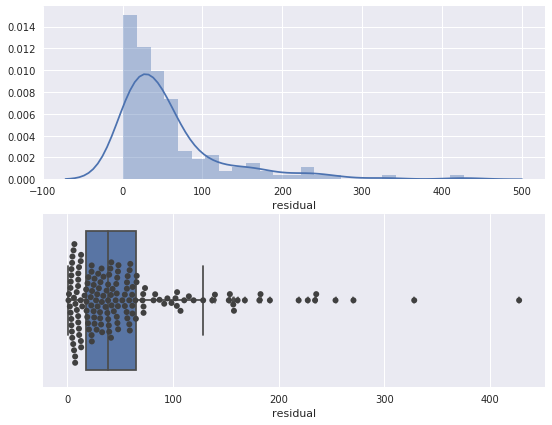

In [5]:
sns.set()
f, (ax1, ax2) = plt.subplots(nrows=2,figsize=(9,7))
sns.distplot(df_residual.residual, ax=ax1)
sns.boxplot(df_residual.residual, ax=ax2)
sns.swarmplot(df_residual.residual, ax=ax2, color=".25", size=6)

In [7]:
q1, q2 = 75, 120

visualization.choropleth_plot(
    data_polygon, 
    df_residual,
    df_dictionary,
    map_style='dark', # dark, satellite, streets, light, outdoors
    cmap_name='summer', # Blues, viridis, RdYlGn, autumn, summer
    none_data_rgba='rgba(0,0,0,0.15)', # rgba(0,0,0,0.15) rgba(255,255,255,1)
    opacity=1,
    is_reverse=False,
    is_category=True,
    q1=q1,
    q2=q2,
#     save_file=True,
#     filename='Nakhon-residual-dark-thresh.html'
)

In [8]:
df_residual_corr = residual.get_residual_corr(df_detect, df_population, df_area, df_residual, df_gsv_coverage, q1=q1, q2=q2)

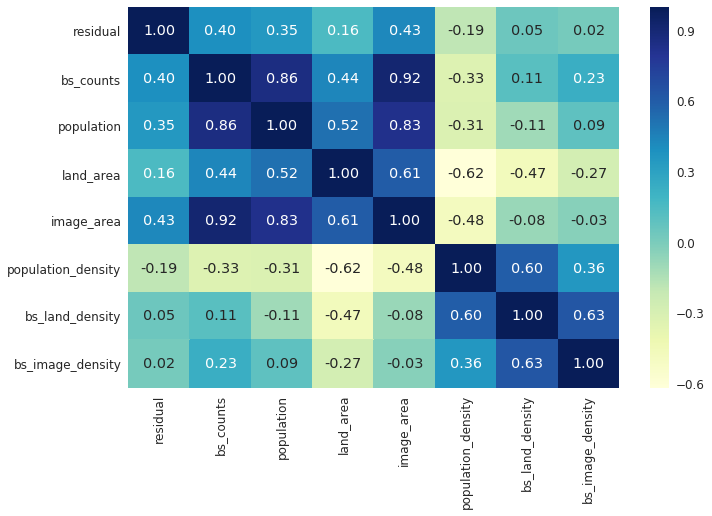

In [9]:
plt.figure(figsize=(11,7))
sns.set(font_scale=1.2)
sns.heatmap(df_residual_corr.corr(),  annot=True, fmt=".2f", cmap="YlGnBu")
plt.show()

'\nFit linear regression models to the scatter plots\n'

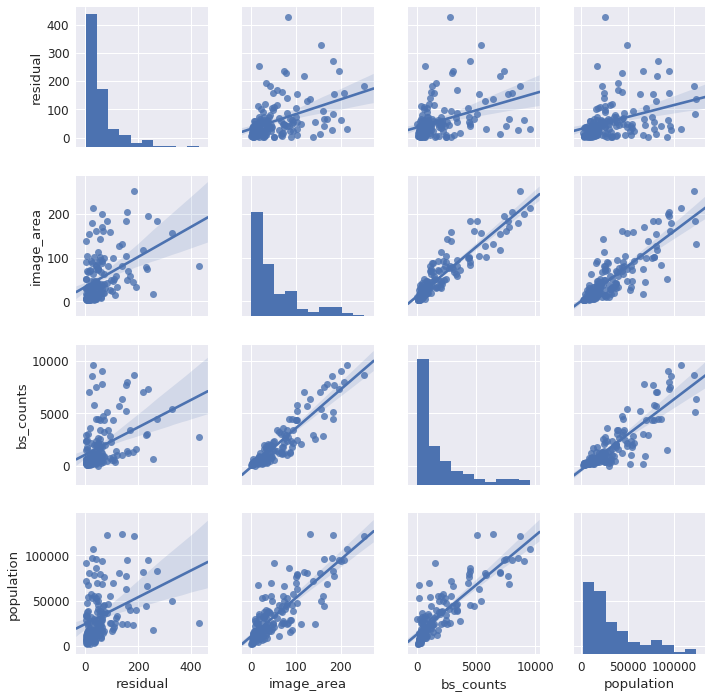

In [11]:
'''
Fit linear regression models to the scatter plots
'''
sns.set(font_scale=1.2)
sns.pairplot(df_residual_corr[['residual','image_area','bs_counts','population', 'category']], kind="reg")
plt.show()
